# Trabalho de conclusão de curso

## Objetivo
Treinar um modelo para previsão de séries temporais visando auxiliar na tomada de decisão dos gestores do Poder Judiciário do RN.

## Possíveis casos de uso

- Previsão do número de ajuizamentos para cada unidade jurisdicional
- Suporte a Corregedoria no processo de inspeção. Desse modo, a inspeção deixa de ser reativa e passa a ser proativa
- Auxílio na definição de novas comarcas e/ou varas

## Metodologia

Adotamos como fonte de dados o DATAJUD - via API oficial. Assim, foi possível baixar os metadados de todos os processos ajuizados a partir de 01/01/2018 no TJRN. Após essa etapa, partimos para o pré-processamento da base, especialmente a conversão de campos e a criação da série temporal.

Foi realizado um estudo exploratório buscando comprender o comportamento de uma parte dos algoritmos presentes na literatura, iniciamos com o algoritmo clássico ARIMA e, na sequência, avaliamos métodos mais atuais como o Prophet, NeuralProphet, DeepAR e N-Beats. Desse modo, buscamos compreender se a adição de métodos com aprendizado profundo traria algum ganho na precisão dos resultados. A métrica adotada para comparação entre os modelos foi a RMSE devido a sua sensibilidade aos outliers. 
Os algoritmos tiveram a sua performance avaliada através do teste estatístico de Friedman com o devido post-hoc.




### Visão geral da solução

<img src="imagens/arquitetura_solucao.png">

## Setup

In [1]:
%pip install -r requirements.txt

Note: you may need to restart the kernel to use updated packages.


In [2]:
import pandas as pd
import numpy as np
import re
import typing
import matplotlib.pyplot as plt
import swifter
import dateutil
import datetime
import kaleido
import plotly
from tqdm import tqdm
from statsmodels.graphics.tsaplots import plot_pacf
from statsmodels.tsa.stattools import adfuller
from pmdarima.arima import KPSSTest, auto_arima
from pmdarima.model_selection import train_test_split
import mariadb

from neuralprophet import NeuralProphet

from lightning.pytorch.tuner import Tuner
import lightning.pytorch as pl
from lightning.pytorch.callbacks import EarlyStopping
import torch
import pytorch_forecasting as ptf

from pytorch_forecasting import Baseline, DeepAR, TimeSeriesDataSet, NBeats
from pytorch_forecasting.data import NaNLabelEncoder
from pytorch_forecasting.metrics import MAE, MAPE, RMSE, SMAPE, NormalDistributionLoss

Importing plotly failed. Interactive plots will not work.
Importing plotly failed. Interactive plots will not work.


## Data preparation

### Loading data

In [3]:
try:
    mydb = mariadb.connect(host="172.17.0.3", database = 'dados_tribunais',user="root", passwd="abc@123")
    query = "select * from processos where grau='JE' and tribunal='TJRN' and orgao_julgador = '4º JUIZADO ESPECIAL DA FAZENDA PÚBLICA';"
    df_tribunal = pd.read_sql(query,mydb)
    mydb.close() #close the connection
except Exception as e:
    mydb.close()
    print(str(e))

WARNING - (py.warnings._showwarnmsg) - /tmp/ipykernel_2114013/3164487814.py:4: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df_tribunal = pd.read_sql(query,mydb)



In [4]:
df_tribunal.shape

(17129, 17)

In [5]:

#df_tribunal = pd.read_csv('dados/processados/serie_temporal_ajuizamento-TJRN_G1_2018.csv', header='infer', sep=';')
df_tribunal.drop(columns=['numero_processo', 'tribunal', 'classe', 'ultima_atualizacao', 'codigo', 'municipio', 'grau', 'assuntos', 'movimentos'], inplace=True, errors='ignore')
print(df_tribunal.head(2))
#df_tribunal['data_ajuizamento'] = df_tribunal['data_ajuizamento'].swifter.apply(dateutil.parser.parse)
#df_tribunal['data_ajuizamento'] = df_tribunal['data_ajuizamento'].swifter.apply(datetime.datetime.date)

#df_tribunal['data_sentenca'] = df_tribunal['data_sentenca'].swifter.apply(dateutil.parser.parse)
#df_tribunal['data_sentenca'] = df_tribunal['data_sentenca'].swifter.apply(datetime.datetime.date)
orgao_julgador = df_tribunal['orgao_julgador'][0]


  data_ajuizamento                          orgao_julgador data_sentenca  \
0       2019-01-02  4º JUIZADO ESPECIAL DA FAZENDA PÚBLICA    2019-01-02   
1       2019-01-02  4º JUIZADO ESPECIAL DA FAZENDA PÚBLICA    2019-03-18   

  tempo_ate_sentenca tempo_entre_1e2_mov tempo_entre_2e3_mov  \
0               None                   0                   0   
1               None                   0                   7   

  tempo_entre_3e4_mov  mais60d  
0                   0        0  
1                   0        0  


In [6]:
df_tribunal.isna().sum()

data_ajuizamento       0
orgao_julgador         0
data_sentenca          0
tempo_ate_sentenca     0
tempo_entre_1e2_mov    0
tempo_entre_2e3_mov    0
tempo_entre_3e4_mov    0
mais60d                0
dtype: int64

In [7]:
df_tribunal['orgao_julgador'].unique()

array(['4º JUIZADO ESPECIAL DA FAZENDA PÚBLICA'], dtype=object)

### Comentário
A base conta com aproximadamente 2,1M de processos judiciais do TJRN e 300 mil processos do TJCE - ainda estamos adicionando informações referente a este Poder Judiciário. Os dados foram extraídos do DATAJUD via API oficial. 

A base não tem registros com dados faltantes, na consulta SQL já definimos que queremos analisar apenas uma serventia - 4º Juizado Especial da Fazenda Pública. Entretanto, a base contempla todo o TJRN em todos os graus de jurisdição.

Para esta análise, removemos todas as informações não essenciais. Estas continuam na base para o caso de estudos científicos posteriores.

In [8]:
dataframe = df_tribunal.groupby(['data_ajuizamento']).size()
df_tribunal = dataframe.to_frame(name='quantidade')
df_tribunal = df_tribunal.rename_axis('data_ajuizamento').reset_index()
print(df_tribunal)

     data_ajuizamento  quantidade
0          2018-01-03           3
1          2018-01-04           3
2          2018-01-08           1
3          2018-01-09           2
4          2018-01-10           1
...               ...         ...
2130       2024-05-02          14
2131       2024-05-03          14
2132       2024-05-04           4
2133       2024-05-06          14
2134       2024-05-07          15

[2135 rows x 2 columns]


### Visualização dos dados

Série Temporal dos ajuizamentos ao longo do tempo

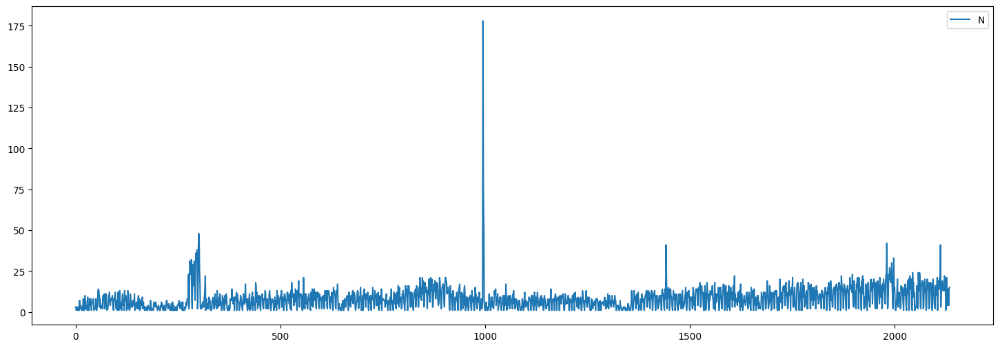

In [9]:
plt.figure(figsize=(18, 6))
plt.plot(df_tribunal['quantidade'])
plt.legend('Número de ajuizamentos')

## Análise estatística

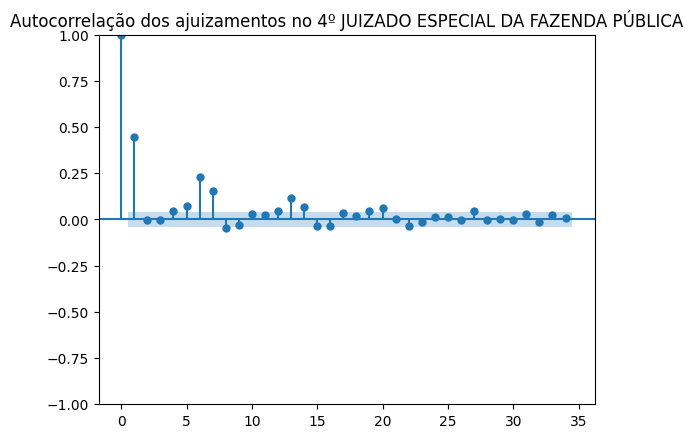

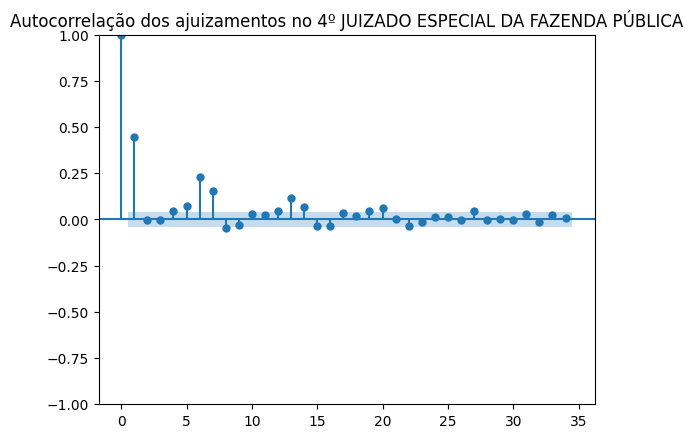

In [10]:
## PACF

df_pacf = df_tribunal
df_pacf.set_index('data_ajuizamento', inplace=True)

plot_pacf(df_pacf, title=f'Autocorrelação dos ajuizamentos no {orgao_julgador}')

In [11]:
adf, pval, usedlag, nobs, crit_vals, icbest =  adfuller(df_pacf.quantidade.values)
print('ADF test statistic:', adf)
print('ADF p-values:', pval)
print('ADF number of lags used:', usedlag)
print('ADF number of observations:', nobs)
print('ADF critical values:', crit_vals)
print('ADF best information criterion:', icbest)

if pval < 0.5:
    print('\n\nA série temporal é estacionária')
else:
    print('\n\nA série temporal não é estacionária')

ADF test statistic: -5.900106670511728
ADF p-values: 2.7910480228884825e-07
ADF number of lags used: 19
ADF number of observations: 2115
ADF critical values: {'1%': -3.433445628558137, '5%': -2.8629075228568746, '10%': -2.5674980038451007}
ADF best information criterion: 13601.888430140903


A série temporal é estacionária


# Métodos e modelos

## Avaliação dos modelos

A métrica que será adotada para a avaliação dos modelos será a RMSE devido a sua característica de evidenciar erros maiores. Por consequência, ela é mais susceptível a outliers.

Cada modelo foi executado 30 vezes, as métricas para cada execução foram armazenadas e depois submetidas ao teste estatístico que será apresentado mais a frente.

In [12]:
metricas = pd.DataFrame(columns=['modelo', 'mse', 'rmse', 'mape', 'mae', 'u_theil', 'ARV', 'POCID'])

## 1. ARIMA e variantes

In [13]:
def mean_square_error(y_true, y_pred):
    y_true = np.asmatrix(y_true).reshape(-1)
    y_pred = np.asmatrix(y_pred).reshape(-1)

    return np.square(np.subtract(y_true, y_pred)).mean()

def root_mean_square_error(y_true, y_pred):

    return mean_square_error(y_true, y_pred)**0.5


def mean_absolute_percentage_error(y_true, y_pred):
    y_true = np.asarray(y_true).reshape(-1)
    y_pred = np.asarray(y_pred).reshape(-1)

    if len(np.where(y_true == 0)[0]) > 0:
        return np.inf
    else:
        return np.mean(np.abs((y_true - y_pred) / y_true)) * 100


def mean_absolute_error(y_true, y_pred):

    y_true = np.asarray(y_true).reshape(-1)
    y_pred = np.asarray(y_pred).reshape(-1)

    return np.mean(np.abs(y_true - y_pred))


def u_theil(y_true, y_pred):
    y_true = np.asarray(y_true).reshape(-1)
    y_pred = np.asarray(y_pred).reshape(-1)

    error_sup = np.square(np.subtract(y_true, y_pred)).sum()
    error_inf = np.square(np.subtract(y_pred[0:(len(y_pred) - 1)], y_pred[1:(len(y_pred))])).sum()

    return error_sup / error_inf


def average_relative_variance(y_true, y_pred):
    y_true = np.asarray(y_true).reshape(-1)
    y_pred = np.asarray(y_pred).reshape(-1)
    mean = np.mean(y_true)

    error_sup = np.square(np.subtract(y_true, y_pred)).sum()
    error_inf = np.square(np.subtract(y_pred, mean)).sum()

    return error_sup / error_inf


def prediction_of_change_in_direction(y_true, y_pred):
    y_true = np.asarray(y_true).reshape(-1)
    y_pred = np.asarray(y_pred).reshape(-1)

    true_sub = np.subtract(y_true[0:(len(y_true) - 1)], y_true[1:(len(y_true))])
    pred_sub = np.subtract(y_pred[0:(len(y_pred) - 1)], y_pred[1:(len(y_pred))])

    mult = true_sub * pred_sub
    result = 0
    for m in mult:
        if m > 0:
            result = result + 1

    return (100 * (result / len(y_true)))


def gerenerate_metric_results(y_true, y_pred):
    return {'MSE': mean_square_error(y_true, y_pred),
            'RMSE':root_mean_square_error(y_true, y_pred),
            'MAPE': mean_absolute_percentage_error(y_true, y_pred),
            'MAE': mean_absolute_error(y_true, y_pred),
            'theil': u_theil(y_true, y_pred),
            'ARV': average_relative_variance(y_true, y_pred),
            'POCID': prediction_of_change_in_direction(y_true, y_pred)}



In [14]:
def arima_fit_predict(ts, m, horizon, test_size):
  ts_train = ts[0:-(test_size+(horizon-1))].values
  ts_test = ts[-(test_size+(horizon-1)):].values

  model = auto_arima(ts_train, #X=None,
            start_p=2, start_q=2, max_p=6, max_d=2,
            max_q=6, start_P=1, start_Q=1, max_P=2,
            max_D=1, max_Q=2, max_order=15, m=m,
            stepwise=True, trace=True)

  direct_predict = model.predict(ts_test.shape[0])

  prevs_h_steps = []

  for t in tqdm(ts_test):
    prevs_h_steps.append(model.predict(horizon)[horizon-1])
    model.update(t)

  return prevs_h_steps[0:test_size], direct_predict[-test_size:]

In [15]:
test_size = 180
m = 30
horizon = 2
ts = df_pacf['quantidade']
for _ in range(30):
    prevs_h_steps, direct_predict = arima_fit_predict(ts, m, horizon, test_size)
    dicionario_predicoes =  gerenerate_metric_results(ts[-test_size:], prevs_h_steps)
    # # 'modelo', 'mse', 'rmse', 'mape', 'mae', 'u_theil', 'ARV', 'POCID'])
    metricas.loc[len(metricas)] = 'arima', dicionario_predicoes['MSE'], dicionario_predicoes['RMSE'], dicionario_predicoes['MAPE'], dicionario_predicoes['MAE'],  dicionario_predicoes['theil'], dicionario_predicoes['ARV'], dicionario_predicoes['POCID']

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=11.40 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=3.03 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=4.16 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=7.29 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.57 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=34.30 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=8.52 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=30.01 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=33.97 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=8.20 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.40 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=26.96 sec


100%|██████████| 181/181 [03:09<00:00,  1.05s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=9.44 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.25 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=3.21 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=6.28 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.48 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=28.92 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=8.52 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=25.70 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=30.71 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=6.92 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.40 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=24.88 sec
 

100%|██████████| 181/181 [03:13<00:00,  1.07s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=11.24 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.17 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=2.59 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=6.60 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.50 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=28.87 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=6.75 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=25.26 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=30.29 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=6.38 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.39 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=23.72 sec


100%|██████████| 181/181 [03:04<00:00,  1.02s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=10.20 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.03 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.62 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=3.40 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=7.69 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.56 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=28.94 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=6.88 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=26.41 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=30.37 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=6.00 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.37 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=24.01 sec


100%|██████████| 181/181 [02:51<00:00,  1.06it/s]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=10.86 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.03 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.92 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=3.22 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=6.95 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.55 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=27.59 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=7.33 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=25.52 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=30.22 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=6.49 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.36 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=23.75 sec


100%|██████████| 181/181 [03:09<00:00,  1.05s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=10.63 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.04 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.76 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=2.77 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.03 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=6.72 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.50 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=34.87 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=7.01 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=25.37 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=30.61 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=7.72 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.41 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=24.17 sec


100%|██████████| 181/181 [03:15<00:00,  1.08s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=11.71 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.93 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=3.84 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=7.47 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.48 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=32.30 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=6.59 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=25.50 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=30.62 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=6.34 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.37 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=23.54 sec


100%|██████████| 181/181 [03:13<00:00,  1.07s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=11.36 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.22 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=3.25 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=6.27 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.59 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=28.88 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=7.76 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=26.02 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=30.77 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=7.42 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.37 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=23.51 sec


100%|██████████| 181/181 [03:05<00:00,  1.03s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=14.77 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.97 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=3.83 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.03 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=6.70 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.56 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=30.43 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=7.79 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=25.81 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=30.62 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=6.04 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.36 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=23.09 sec


100%|██████████| 181/181 [03:06<00:00,  1.03s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=10.02 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.59 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=3.05 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=5.60 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.60 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=27.28 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=6.59 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=26.81 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=30.67 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=6.65 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.36 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=23.68 sec


100%|██████████| 181/181 [03:04<00:00,  1.02s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=11.08 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.03 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.92 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=2.77 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=6.84 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.48 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=29.43 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=6.86 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=25.16 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=30.52 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=6.80 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.43 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=23.48 sec


100%|██████████| 181/181 [04:29<00:00,  1.49s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=12.58 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.86 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=3.38 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=8.73 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.68 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=185.39 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=9.25 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=28.57 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=35.23 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=11.09 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.44 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=25.66 se

100%|██████████| 181/181 [04:09<00:00,  1.38s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=9.91 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.43 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=2.74 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=7.34 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.60 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=29.84 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=6.81 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=26.18 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=31.00 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=7.12 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.36 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=23.33 sec
 

100%|██████████| 181/181 [03:07<00:00,  1.03s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=9.50 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.42 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=3.77 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=7.17 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.50 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=24.34 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=7.77 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=25.76 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=29.54 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=6.84 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.37 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=23.47 sec
 

100%|██████████| 181/181 [02:56<00:00,  1.03it/s]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=9.90 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=1.87 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=3.72 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=5.71 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.54 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=26.72 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=6.35 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=25.10 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=30.08 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=7.65 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.51 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=22.98 sec
 

100%|██████████| 181/181 [02:54<00:00,  1.04it/s]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=11.24 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=1.87 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=2.58 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=6.85 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.46 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=30.18 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=6.78 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=24.55 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=30.49 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=7.28 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.36 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=22.68 sec


100%|██████████| 181/181 [03:10<00:00,  1.05s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=12.73 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.77 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=4.34 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.03 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=7.53 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.63 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=25.33 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=7.38 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=25.40 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=30.89 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=6.66 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.35 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=24.98 sec


100%|██████████| 181/181 [04:18<00:00,  1.43s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=12.46 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.62 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=2.58 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=7.75 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.59 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=31.78 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=7.65 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=28.80 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=32.56 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=6.60 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.37 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=25.61 sec


100%|██████████| 181/181 [03:41<00:00,  1.23s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=10.28 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.04 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=3.25 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=2.89 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=8.17 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=1.34 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=38.51 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=8.27 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=27.43 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=34.61 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=8.08 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.53 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=26.16 sec


100%|██████████| 181/181 [04:26<00:00,  1.47s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=14.80 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.03 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=4.10 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=6.33 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.03 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=8.37 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.53 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=43.20 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=8.23 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=28.60 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=34.95 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=8.78 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.39 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=26.72 sec


100%|██████████| 181/181 [04:11<00:00,  1.39s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=12.36 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.03 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=3.08 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=3.30 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=8.41 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.50 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=38.59 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=7.92 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=27.29 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=32.58 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=9.62 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.40 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=28.43 sec


100%|██████████| 181/181 [04:03<00:00,  1.34s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=13.63 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.80 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=4.40 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.03 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=8.69 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.61 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=44.72 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=9.20 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=27.39 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=32.11 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=8.18 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.56 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=24.72 sec


100%|██████████| 181/181 [04:00<00:00,  1.33s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=14.57 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.03 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.88 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=2.98 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=7.56 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.51 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=38.60 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=9.67 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=30.14 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=32.62 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=9.23 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.46 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=27.47 sec


100%|██████████| 181/181 [03:14<00:00,  1.07s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=9.94 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.09 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=2.55 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=6.83 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.46 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=25.30 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=6.97 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=27.52 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=31.05 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=6.33 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.47 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=22.36 sec
 

100%|██████████| 181/181 [02:50<00:00,  1.06it/s]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=10.04 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.24 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=2.57 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=6.20 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.47 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=29.26 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=6.41 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=24.45 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=33.99 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=7.33 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.38 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=26.62 sec


100%|██████████| 181/181 [03:10<00:00,  1.05s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=12.13 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=1.83 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=3.19 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.03 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=6.17 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.48 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=30.50 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=6.75 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=25.02 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=30.28 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=6.58 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.36 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=23.10 sec


100%|██████████| 181/181 [03:06<00:00,  1.03s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=11.93 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.41 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=3.52 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=6.46 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.50 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=26.31 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=8.54 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=25.12 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=29.43 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=6.26 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.36 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=22.71 sec


100%|██████████| 181/181 [03:15<00:00,  1.08s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=11.02 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.33 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=3.26 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=7.53 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.51 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=28.84 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=7.14 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=26.56 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=30.41 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=6.16 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.36 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=22.58 sec


100%|██████████| 181/181 [03:05<00:00,  1.02s/it]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=10.10 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.03 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.30 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=2.56 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=6.36 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.48 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=24.10 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=7.08 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=24.47 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=29.55 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=6.35 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.34 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=22.48 sec


100%|██████████| 181/181 [02:43<00:00,  1.10it/s]


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(1,0,1)[30] intercept   : AIC=12644.154, Time=11.73 sec
 ARIMA(0,1,0)(0,0,0)[30] intercept   : AIC=13323.499, Time=0.02 sec
 ARIMA(1,1,0)(1,0,0)[30] intercept   : AIC=13150.422, Time=2.73 sec
 ARIMA(0,1,1)(0,0,1)[30] intercept   : AIC=12857.922, Time=3.36 sec
 ARIMA(0,1,0)(0,0,0)[30]             : AIC=13321.499, Time=0.02 sec
 ARIMA(2,1,2)(0,0,1)[30] intercept   : AIC=12642.258, Time=6.77 sec
 ARIMA(2,1,2)(0,0,0)[30] intercept   : AIC=12650.787, Time=0.49 sec
 ARIMA(2,1,2)(0,0,2)[30] intercept   : AIC=12644.143, Time=25.37 sec
 ARIMA(2,1,2)(1,0,0)[30] intercept   : AIC=12642.157, Time=7.79 sec
 ARIMA(2,1,2)(2,0,0)[30] intercept   : AIC=12644.151, Time=25.53 sec
 ARIMA(2,1,2)(2,0,1)[30] intercept   : AIC=12646.156, Time=31.73 sec
 ARIMA(1,1,2)(1,0,0)[30] intercept   : AIC=12637.807, Time=6.09 sec
 ARIMA(1,1,2)(0,0,0)[30] intercept   : AIC=12646.710, Time=0.38 sec
 ARIMA(1,1,2)(2,0,0)[30] intercept   : AIC=12639.793, Time=24.57 sec


100%|██████████| 181/181 [03:20<00:00,  1.11s/it]


<Axes: xlabel='data_ajuizamento'>

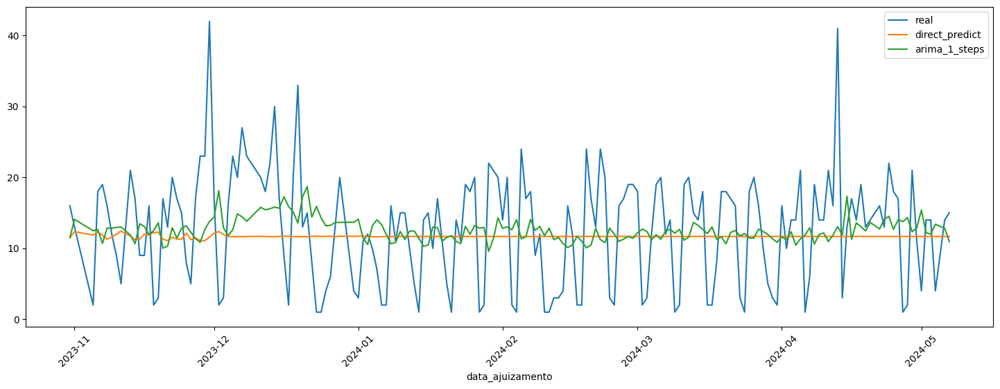

In [16]:
df_result = pd.DataFrame(
    {
        'real': ts.iloc[-test_size:],
        'direct_predict': direct_predict,
        'arima_1_steps': prevs_h_steps,
    }
)
df_result.plot(rot=45, figsize=(18, 6))

In [17]:
y_true = ts.iloc[-test_size:]
metric_results = []
for model_name in ['direct_predict', 'arima_1_steps']:
  y_true = df_result['real']
  y_pred = df_result[model_name]
  dict_result = gerenerate_metric_results(y_true, y_pred)
  dict_result['model_name'] = model_name
  metric_results.append(dict_result)
  
pd.DataFrame(metric_results)  

,MSE,RMSE,MAPE,MAE,theil,ARV,POCID,model_name
0,63.692221,7.980741,165.297123,6.640405,1521.617274,60.240492,39.444444,direct_predict
1,65.935778,8.120085,181.702093,6.750376,27.370318,26.250892,38.888889,arima_1_steps


## 2. NeuralProphet

In [18]:
dados = pd.DataFrame()
df_tribunal.reset_index(inplace=True)
dados['ds'] = df_tribunal['data_ajuizamento']
dados['y'] = df_tribunal['quantidade']

In [19]:
#dados.to_csv('dados/neural_prophet_TJRN_G1_2018.csv', header=True, sep=';', index=False)

In [20]:
#dados = pd.read_csv('dados/neural_prophet_TJRN_G1_2018.csv', header='infer', sep=';')
#dados = dados[dados.y < 6000]

for _ in range(30):
    m = NeuralProphet(n_lags=1, n_forecasts=30, ar_layers=(16, 64))
    m = m.add_country_holidays("BR")
    m.set_plotting_backend("plotly-static")
    df_train, df_val = m.split_df(dados, valid_p=0.25)
    metrics = m.fit(df_train, validation_df=df_val, freq='D', progress="None")
    # # 'modelo', 'mse', 'rmse', 'mape', 'mae', 'u_theil', 'ARV', 'POCID'])
    metricas.loc[len(metricas)] = 'NeuralProphet', metrics['MAE_val'].mean(),  metrics['RMSE_val'].mean(), 0, 0, 0, 0, 0
forecast = m.predict(dados)
m.plot(forecast)

INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.init_data_params) - Setting normalization to global

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_6300fc0e-c749-42e7-8cf0-91cf3dfd7b29.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_6300fc0e-c749-42e7-8cf0-91cf3dfd7b29.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_3d01e06a-16c6-430d-a324-a6cbf25c6172.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_3d01e06a-16c6-430d-a324-a6cbf25c6172.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_16f7ce5e-5506-4874-8635-42fbe60fbdba.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_16f7ce5e-5506-4874-8635-42fbe60fbdba.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_a561ca34-4dae-4c35-b027-4653196ae82d.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_a561ca34-4dae-4c35-b027-4653196ae82d.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_a2a22b7f-84c7-4caf-8352-719fa60ae39d.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_a2a22b7f-84c7-4caf-8352-719fa60ae39d.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_5eae9bd7-7f37-49a4-a3bb-5cc37be56bc7.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_5eae9bd7-7f37-49a4-a3bb-5cc37be56bc7.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_1bc88cb5-5a98-4ae2-a95c-af47b3a2f0b9.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_1bc88cb5-5a98-4ae2-a95c-af47b3a2f0b9.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_507b4bf3-8273-46ca-a0fd-70e8bb4c6977.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_507b4bf3-8273-46ca-a0fd-70e8bb4c6977.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_152639d4-68ff-438d-8b87-ac48b580a13d.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_152639d4-68ff-438d-8b87-ac48b580a13d.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_f0e2888f-1f08-4d7e-a42f-e9cd76254da2.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_f0e2888f-1f08-4d7e-a42f-e9cd76254da2.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_5d082618-b26d-4b1e-8ec9-8f9e6a7600c9.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_5d082618-b26d-4b1e-8ec9-8f9e6a7600c9.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_37b06136-2367-4597-aecb-c37b7c17c265.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_37b06136-2367-4597-aecb-c37b7c17c265.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_645f22cb-c911-4fa7-8778-5d314825d4e1.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_645f22cb-c911-4fa7-8778-5d314825d4e1.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_2fe4ed2e-0b20-456d-8f18-b2872234d093.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_2fe4ed2e-0b20-456d-8f18-b2872234d093.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_db6c1df9-eca4-407d-94f3-88be97e0dce6.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_db6c1df9-eca4-407d-94f3-88be97e0dce6.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_ba1e84ae-75d5-438c-aae4-6babe4bab964.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_ba1e84ae-75d5-438c-aae4-6babe4bab964.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_04e91f96-a716-4272-b9f1-c9c8a9cab761.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_04e91f96-a716-4272-b9f1-c9c8a9cab761.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_990305f2-d069-47c7-b6b4-0f47f002737a.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_990305f2-d069-47c7-b6b4-0f47f002737a.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_cf5bc594-09c2-4245-bdcf-de10a750de89.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_cf5bc594-09c2-4245-bdcf-de10a750de89.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_6cb04d92-6b34-4be2-954b-97b5bc026324.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_6cb04d92-6b34-4be2-954b-97b5bc026324.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_054d544e-65c8-4398-93d1-0f4740fe3c69.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_054d544e-65c8-4398-93d1-0f4740fe3c69.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_544a9995-2774-49cd-a2f6-c6112cd6b42b.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_544a9995-2774-49cd-a2f6-c6112cd6b42b.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_ecf33a71-c865-4d8f-b389-a11762de1eb0.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_ecf33a71-c865-4d8f-b389-a11762de1eb0.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_56ef543a-9751-43d9-a921-cf792725393b.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_56ef543a-9751-43d9-a921-cf792725393b.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_70305f9b-0b9c-4afa-8c73-1c227bd4a4af.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_70305f9b-0b9c-4afa-8c73-1c227bd4a4af.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_f7e5defe-c8cf-4f3e-88e0-82e18ae1602c.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_f7e5defe-c8cf-4f3e-88e0-82e18ae1602c.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_472ca0f8-9f1b-4fd5-8154-fde3ac41e471.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_472ca0f8-9f1b-4fd5-8154-fde3ac41e471.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_1bdfadb0-cb21-46e0-b624-acdb41644ae1.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_1bdfadb0-cb21-46e0-b624-acdb41644ae1.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_0be2785b-d45c-49fa-9364-cafdfbbc4d97.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_0be2785b-d45c-49fa-9364-cafdfbbc4d97.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.in

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_c6e9b5aa-7e05-4a81-a15a-b4aa4115b384.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_c6e9b5aa-7e05-4a81-a15a-b4aa4115b384.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.


Predicting: 53it [00:00, ?it/s]

INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column


In [21]:
m.plot_components(forecast)

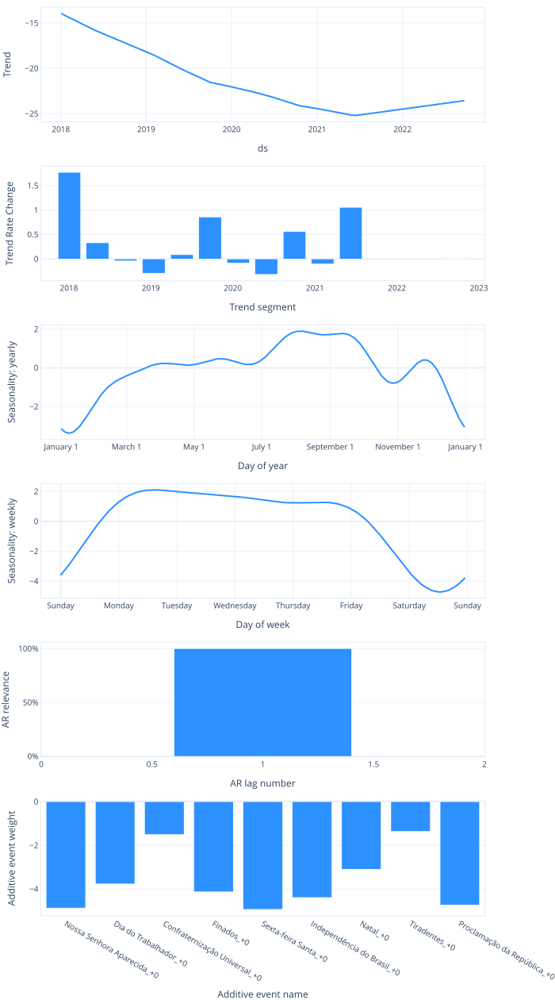

In [22]:
m.plot_parameters()

In [23]:
print(metrics.tail(5))

     MAE_val  RMSE_val  Loss_val  RegLoss_val  epoch       MAE      RMSE  \
95  4.406593  5.847205  0.194919          0.0     95  3.210746  6.106400   
96  4.425274  5.873631  0.196247          0.0     96  3.203959  6.193245   
97  4.465600  5.932746  0.199173          0.0     97  3.208601  6.139793   
98  4.429361  5.880552  0.196561          0.0     98  3.210412  6.066958   
99  4.438088  5.893338  0.197198          0.0     99  3.203820  6.139586   

        Loss  RegLoss  
95  0.088266      0.0  
96  0.088191      0.0  
97  0.088289      0.0  
98  0.088159      0.0  
99  0.088158      0.0  


In [24]:
print(dados['y'].describe())

count    2135.000000
mean        8.022951
std         7.133546
min         1.000000
25%         3.000000
50%         7.000000
75%        11.000000
max       178.000000
Name: y, dtype: float64


## 3. Prophet

In [25]:
recesso_judiciario = pd.DataFrame({
  'holiday': 'recesso_judiciario',
  'ds': pd.to_datetime(['2018-12-19', '2019-12-19', 
                        '2020-12-19', '2021-12-19',
                        '2022-12-19', '2023-12-19',
                        '2024-12-19', '2025-12-19']),
  'lower_window': 0,
  'upper_window': 18,
})

In [26]:
from prophet import Prophet
from prophet.diagnostics import cross_validation
from prophet.diagnostics import performance_metrics
from prophet.plot import plot_cross_validation_metric
import itertools

for _ in range(30):
    m = Prophet(changepoint_prior_scale=0.5, seasonality_prior_scale=0.01,interval_width=0.99, holidays=recesso_judiciario)
    m.add_country_holidays(country_name='BR')
    m.fit(dados)
    df_cv = cross_validation(m, initial='1080 days', period='30 days', horizon = '180 days', parallel="processes")

    df_p = performance_metrics(df_cv)
    #print(df_p.columns)
    metricas.loc[len(metricas)] = 'Prophet', df_p['mse'].mean(), df_p['rmse'].mean(), df_p['mape'].mean(), df_p['mae'].mean(), 0, 0, 0
    #df_p.head(5)

23:43:28 - cmdstanpy - INFO - Chain [1] start processing
23:43:28 - cmdstanpy - INFO - Chain [1] done processing
23:43:30 - cmdstanpy - INFO - Chain [1] start processing
23:43:30 - cmdstanpy - INFO - Chain [1] start processing
23:43:30 - cmdstanpy - INFO - Chain [1] start processing
23:43:30 - cmdstanpy - INFO - Chain [1] start processing
23:43:30 - cmdstanpy - INFO - Chain [1] start processing
23:43:30 - cmdstanpy - INFO - Chain [1] start processing
23:43:30 - cmdstanpy - INFO - Chain [1] start processing
23:43:30 - cmdstanpy - INFO - Chain [1] start processing
23:43:30 - cmdstanpy - INFO - Chain [1] start processing
23:43:30 - cmdstanpy - INFO - Chain [1] start processing
23:43:30 - cmdstanpy - INFO - Chain [1] start processing
23:43:30 - cmdstanpy - INFO - Chain [1] start processing
23:43:31 - cmdstanpy - INFO - Chain [1] done processing
23:43:31 - cmdstanpy - INFO - Chain [1] done processing
23:43:31 - cmdstanpy - INFO - Chain [1] done processing
23:43:32 - cmdstanpy - INFO - Chain

WARNING - (py.warnings._showwarnmsg) - /tmp/ipykernel_2114013/481289654.py:2: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown




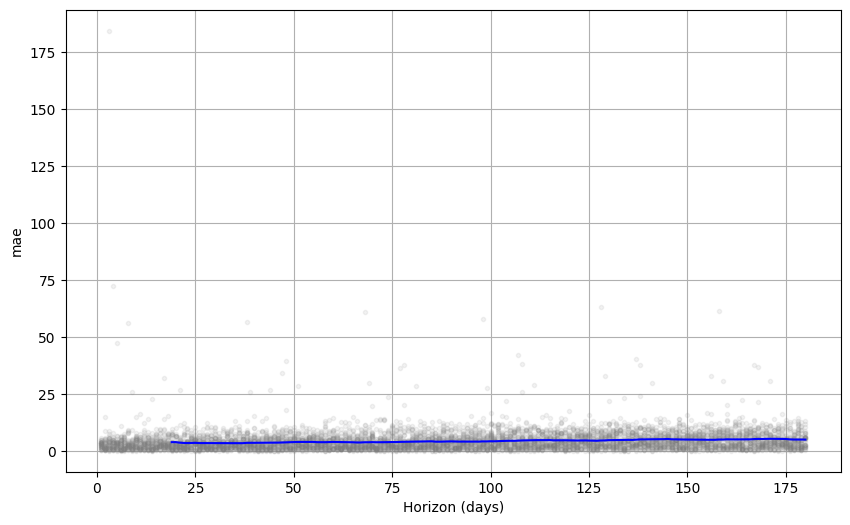

In [27]:
fig = plot_cross_validation_metric(df_cv, metric='mae')
fig.show()

## 4. DeepAR

In [28]:
data = df_pacf.reset_index()
#data['data_ajuizamento'] = data['data_ajuizamento'].swifter.apply(dateutil.parser.parse)
data['idx'] = range(len(data))
data['group'] = 0
data['quantidade'] = data['quantidade'].astype(np.float64)
torch.set_float32_matmul_precision('medium')
                                   
# create dataset and dataloaders
max_encoder_length = 180
max_prediction_length = 30

training_cutoff = data["idx"].max() - max_prediction_length
print((training_cutoff))
context_length = max_encoder_length
prediction_length = max_prediction_length

training = TimeSeriesDataSet(
    data[lambda x: x.idx <= training_cutoff],
    time_idx="idx",
    target="quantidade",
    categorical_encoders={"group": NaNLabelEncoder().fit(data.group)},
    group_ids=['group'],
    time_varying_unknown_reals=["quantidade"],
    max_encoder_length=context_length,
    max_prediction_length=prediction_length,
    allow_missing_timesteps=True
)

validation = TimeSeriesDataSet.from_dataset(training, data, min_prediction_idx=training_cutoff + 1, predict=True, stop_randomization=True)
batch_size = 128
# synchronize samples in each batch over time - only necessary for DeepVAR, not for DeepAR
train_dataloader = training.to_dataloader(
    train=True, batch_size=batch_size, num_workers=11, batch_sampler="synchronized"
)
val_dataloader = validation.to_dataloader(
    train=False, batch_size=batch_size, num_workers=11, batch_sampler="synchronized"
)

baseline_predictions = Baseline().predict(val_dataloader, trainer_kwargs=dict(accelerator="gpu"), return_y=True)
print('RMSE (Baseline): ' + str(RMSE()(baseline_predictions.output, baseline_predictions.y)))

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/pytorch_forecasting/data/samplers.py:86: UserWarning:

Less than 128 samples available for 1896 prediction times. Use batch size smaller than 128. First 10 prediction times with small batch sizes: [181, 182, 183, 184, 185, 186, 187, 188, 189, 190]


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.




2104


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


RMSE (Baseline): tensor(10.7378, device='cuda:0')


In [29]:
trainer = pl.Trainer(accelerator="gpu", gradient_clip_val=1e-1, limit_train_batches=200, max_epochs=150, fast_dev_run=False, enable_progress_bar=True)

net = DeepAR.from_dataset(
    training,
    learning_rate=3e-2,
    hidden_size=50,
    rnn_layers=3,
    loss=NormalDistributionLoss(),
    optimizer="Adam",
)

from lightning.pytorch.tuner import Tuner

res = Tuner(trainer).lr_find(
    net,
    train_dataloaders=train_dataloader,
    val_dataloaders=val_dataloader,
    min_lr=1e-7,
    max_lr=1e0,
    early_stop_threshold=300,
)

net.hparams.learning_rate = res.suggestion()

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=100` reached.
Learning rate set to 5.62341325190349e-06
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_228b840e-bb14-4685-8ad6-9ec7b6ae2a27.ckpt
Restored all states from the checkpoint at /opt/spark/tcc/tcc_cesar/.lr_find_228b840e-bb14-4685-8ad6-9ec7b6ae2a27.ckpt


In [30]:
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1e-4, patience=10, verbose=False, mode="min")
trainer = pl.Trainer(
    max_epochs=150,
    accelerator="gpu",
    enable_model_summary=True,
    gradient_clip_val=0.1,
    callbacks=[early_stop_callback],
    limit_train_batches=50,
    enable_checkpointing=True,
)


net = DeepAR.from_dataset(
    training,
    learning_rate=1e-2,
    log_interval=10,
    log_val_interval=1,
    hidden_size=25,
    rnn_layers=2,
    optimizer="Adam",
    loss=NormalDistributionLoss(),
)

for _ in range(30):
    trainer.fit(
        net,
        train_dataloaders=train_dataloader,
        val_dataloaders=val_dataloader,
    )

    best_model_path = trainer.checkpoint_callback.best_model_path
    best_model = DeepAR.load_from_checkpoint(best_model_path)
    predictions = best_model.predict(val_dataloader, trainer_kwargs=dict(accelerator="gpu"), return_y=True)
    # # 'modelo', 'mse', 'rmse', 'mape', 'mae', 'u_theil', 'ARV', 'POCID'])
    metricas.loc[len(metricas)] = 'DeepAR', 0 , str(RMSE()(predictions.output, predictions.y)), str(MAPE()(predictions.output, predictions.y)), str(MAE()(predictions.output, predictions.y)), 0,0,0
    raw_predictions = net.predict(
        val_dataloader, mode="raw", return_x=True, n_samples=30, trainer_kwargs=dict(accelerator="gpu")
    )

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name                   | Type                   | Params
------------------------------------------------------------------
0 | loss                   | NormalDistributionLoss | 0     
1 | logging_metrics        | ModuleList             | 0     
2 | embeddings             | MultiEmbedding         | 0     
3 | rnn                    | LSTM                   | 8.0 K 
4 | distribution_projector | Linear                 | 52    
------------------------------------------------------------------
8.1 K     Trainable params
0         Non-trainable params
8.1 K     Total params
0.032     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/callbacks/model_checkpoint.py:653: UserWarning:

Checkpoint directory /opt/spark/tcc/tcc_cesar/lightning_logs/version_253/checkpoints exists and is not empty.


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name                   | Type                   | Params
------------------------------------------------------------------
0 | loss                   | NormalDistributionLoss | 0     
1 | logging_metrics        | ModuleList             | 0     
2 | embeddings             | MultiEmbedding         | 0     


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCA

## 5. N-Beats

In [31]:
trainer = pl.Trainer(gradient_clip_val=0.01)
net = NBeats.from_dataset(training, 
                          learning_rate=3e-2, 
                          weight_decay=1e-2, 
                          widths=[32, 512], 
                          backcast_loss_ratio=0.1)

# find optimal learning rate
from lightning.pytorch.tuner import Tuner

res = Tuner(trainer).lr_find(net, train_dataloaders=train_dataloader, val_dataloaders=val_dataloader, min_lr=1e-5)
net.hparams.learning_rate = res.suggestion()

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_metrics' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['logging_metrics'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/pytorch_forecasting/models/nbeats/sub_modules.py:154: UserWarning:

Creating a tensor from a list of numpy.ndarrays is 

Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]

LR finder stopped early after 15 steps due to diverging loss.
Learning rate set to 3.981071705534973e-05
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_f695bc2f-73fe-4829-a517-61428893529a.ckpt
Restored all states from the checkpoint at /opt/spark/tcc/tcc_cesar/.lr_find_f695bc2f-73fe-4829-a517-61428893529a.ckpt


In [32]:
early_stop_callback = EarlyStopping(monitor="val_loss", min_delta=1e-4, patience=10, verbose=False, mode="min")
for _ in range(30):
    trainer = pl.Trainer(
        max_epochs=100,
        accelerator="gpu",
        enable_model_summary=True,
        gradient_clip_val=0.01,
        callbacks=[early_stop_callback],
        limit_train_batches=150,
    )


    net = NBeats.from_dataset(
        training,
        learning_rate=res.suggestion(),
        log_interval=10,
        log_val_interval=1,
        weight_decay=1e-2,
        widths=[32, 512],
        backcast_loss_ratio=1.0
    )

    trainer.fit(
        net,
        train_dataloaders=train_dataloader,
        val_dataloaders=val_dataloader,
    )

    best_model_path = trainer.checkpoint_callback.best_model_path
    best_model = NBeats.load_from_checkpoint(best_model_path)
    actuals = torch.cat([y[0] for x, y in iter(val_dataloader)])
    predictions = best_model.predict(val_dataloader, trainer_kwargs=dict(accelerator="cpu"), return_y=True)
    metricas.loc[len(metricas)] = 'N-Beats', 0 , str(RMSE()(predictions.output, predictions.y)), str(MAPE()(predictions.output, predictions.y)), str(MAE()(predictions.output, predictions.y)), 0,0,0



GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name            | Type       | Params
-----------------------------------------------
0 | loss            | MASE       | 0     
1 | logging_metrics | ModuleList | 0     
2 | net_blocks      | ModuleList | 1.9 M 
-----------------------------------------------
1.9 M     Trainable params
0         Non-trainable params
1.9 M     Total params
7.696     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'loss' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['loss'])`.


WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/utilities/parsing.py:199: UserWarning:

Attribute 'logging_

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
WARNING - (py.warnings._showwarnmsg) - /usr/local/lib/python3.10/dist-packages/lightning/pytorch/trainer/setup.py:187: PossibleUserWarning:

GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.




## Testes estatísticos

Foi adotado o teste estatístico de Friedman e o post-hoc Nemeyi para avaliar os métodos.

### Uma breve explicação sobre o teste estatístico de Friedman

O teste estatístico de Friedman é um procedimento não paramétrico utilizado para comparar múltiplos conjuntos de dados relacionados. Ele é frequentemente aplicado quando temos várias amostras dependentes e queremos determinar se há diferenças significativas entre elas.

O teste de Friedman é baseado na classificação dos dados em cada conjunto e na comparação das classificações médias. Ele considera a hipótese nula de que não há diferenças significativas entre os grupos. Se o valor-p resultante do teste for menor que um nível de significância pré-determinado, podemos rejeitar a hipótese nula e concluir que pelo menos um dos grupos é estatisticamente diferente dos demais.

Uma vez que o teste de Friedman indica que há diferenças significativas entre os grupos, é comum realizar um teste post-hoc para identificar quais grupos são diferentes entre si. O post-hoc de Nemeyi é um exemplo de teste que pode ser aplicado nessa situação. Ele compara todos os pares de grupos e determina se as diferenças observadas são estatisticamente significativas.

Em resumo, o teste estatístico de Friedman é uma ferramenta útil para comparar múltiplos conjuntos de dados relacionados e identificar diferenças significativas entre eles. Ele nos ajuda a tomar decisões informadas com base em evidências estatísticas.


In [33]:
def extrair_valores(elemento):
    return re.search(r'(\d[.0-9])\w+', elemento).group(0)

In [34]:
from scipy import stats
df_arima = metricas[metricas['modelo'] == 'arima']['rmse'].to_numpy( dtype=float)
df_prophet = metricas[metricas['modelo'] == 'Prophet']['rmse'].to_numpy( dtype=float)
df_neuralProphet = metricas[metricas['modelo'] == 'NeuralProphet']['rmse'].to_numpy()
df_deepar = metricas[metricas['modelo'] == 'DeepAR']['rmse'].apply(extrair_valores).to_numpy(dtype=float)
df_nbeats = metricas[metricas['modelo'] == 'N-Beats']['rmse'].apply(extrair_valores).to_numpy(dtype=float)
stats.friedmanchisquare(df_arima, df_prophet, df_neuralProphet, df_deepar, df_nbeats)

FriedmanchisquareResult(statistic=46.5866666666667, pvalue=1.8591780247971248e-09)

In [35]:
import scikit_posthocs as sp

dados_metodos = np.array([df_arima, df_prophet, df_neuralProphet, df_deepar, df_nbeats])
sp.posthoc_nemenyi_friedman(dados_metodos.T)

,0,1,2,3,4
0,1.000000,0.009628,0.001176,0.329183,0.900000
1,0.009628,1.000000,0.900000,0.001000,0.012629
2,0.001176,0.900000,1.000000,0.001000,0.001624
3,0.329183,0.001000,0.001000,1.000000,0.286112
4,0.900000,0.012629,0.001624,0.286112,1.000000


## Conclusão

- O DeepAR e o N-Beats não obtiveram um desempenho superior ao Prophet e NeuralProphet
- O Arima obteve um resultado semelhante ao DeepAR e N-Beats
- Os dois melhores algoritmos para esta série temporal com esta modelagem foram o Prophet e NeuralProphet (sem distinção entre os dois)

## Aprofundamento com o NeuralProphet

In [36]:
dados = pd.DataFrame()
df_tribunal.reset_index(inplace=True)
dados['ds'] = df_tribunal['data_ajuizamento']
dados['y'] = df_tribunal['quantidade']

In [37]:
m = NeuralProphet(n_lags=30, n_forecasts=30, ar_layers=(16, 64, 32), quantiles=[0.9], lagged_reg_layers=[8, 64])
m = m.add_country_holidays("BR")
m.set_plotting_backend("plotly-static")
df_train, df_val = m.split_df(dados, valid_p=0.25)
metrics = m.fit(df_train, validation_df=df_val, freq='D', progress="None")
forecast = m.predict(dados)
m.highlight_nth_step_ahead_of_each_forecast(15).plot(forecast, figsize=(14, 8))

INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Dataframe freq automatically defined as D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 99.942% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.config.init_data_params) - Setting normalization to global

Finding best initial lr:   0%|          | 0/231 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_steps=231` reached.
Restoring states from the checkpoint path at /opt/spark/tcc/tcc_cesar/.lr_find_c611633b-01be-41a5-81ea-4cf56006ecaf.ckpt
Restored all states from the checkpoint file at /opt/spark/tcc/tcc_cesar/.lr_find_c611633b-01be-41a5-81ea-4cf56006ecaf.ckpt
Loading `train_dataloader` to estimate number of stepping batches.


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.data.processing._handle_missing_data) - Added 182 missing dates.
WARNING - (NP.data.processing._handle_missing_data) - 182 missing values in column y were detected in total. 
INFO - (NP.data.processing._handle_missing_data) - 182 NaN values in column y were auto-imputed.


Predicting: 53it [00:00, ?it/s]

INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column


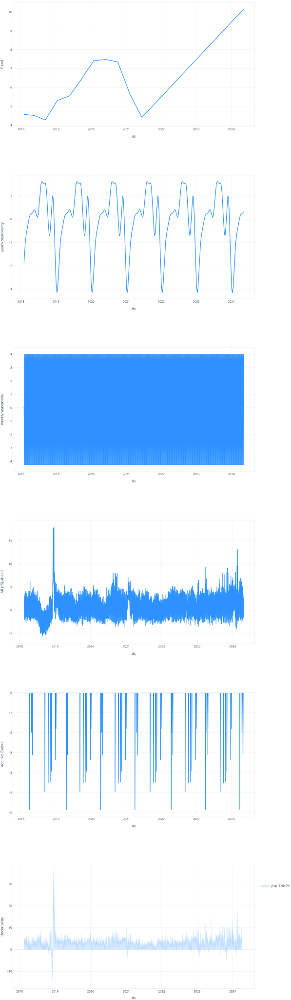

In [38]:
m.plot_components(forecast, figsize=(14, 8))

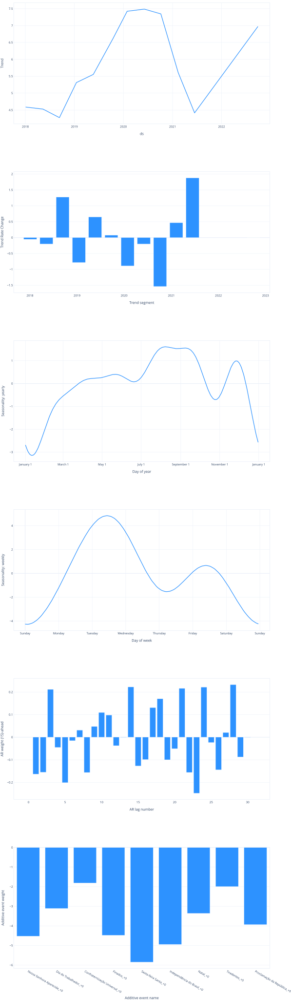

In [39]:
m.plot_parameters(figsize=(14, 8))

In [40]:
print(metrics.tail(1))

     MAE_val  RMSE_val  Loss_val  RegLoss_val  epoch       MAE      RMSE  \
99  3.711293  4.932722  0.196937          0.0     99  2.632732  5.577365   

        Loss  RegLoss  
99  0.094838      0.0  


In [41]:
print(dados['y'].describe())

count    2135.000000
mean        8.022951
std         7.133546
min         1.000000
25%         3.000000
50%         7.000000
75%        11.000000
max       178.000000
Name: y, dtype: float64


### Prevendo os próximos 12 meses

INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 93.583% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
WARNING - (NP.data.splitting._make_future_dataframe) - Number of forecast steps is defined by n_forecasts. Adjusted to 30.
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 95.758% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 95.758% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO - (NP.data.processing._handle_missing_data) - Added 18 missing dates.
INFO - (NP.data.processing._handle_missing_data) - Dropped 30 rows at the end with NaNs in 'y' column.
WARNING - (NP.data.processing._handle_missing_data) - 18 missing

Predicting: 53it [00:00, ?it/s]

INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column


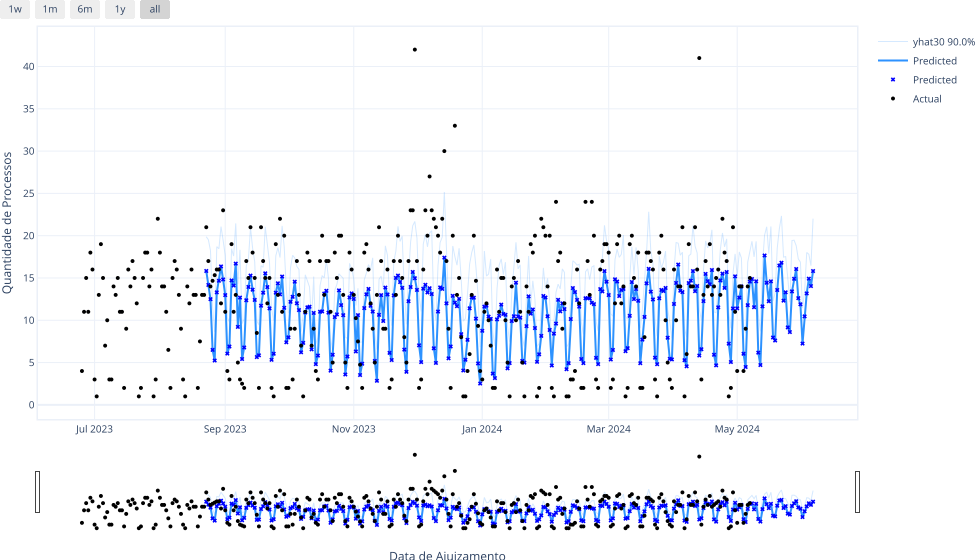

In [42]:
future = m.make_future_dataframe(dados, periods=365, n_historic_predictions=270)
forecast = m.predict(future)
#m.plot(forecast, figsize=(14, 8), xlabel='Data de Ajuizamento', ylabel='Quantidade de Processos')
m.highlight_nth_step_ahead_of_each_forecast(30).plot(forecast, figsize=(14, 8), xlabel='Data de Ajuizamento', ylabel='Quantidade de Processos')

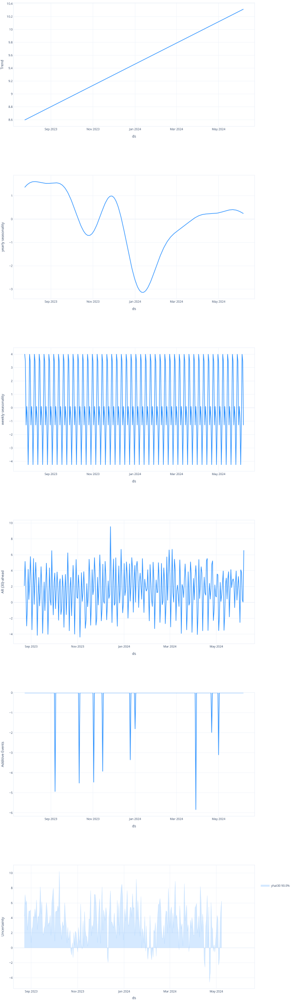

In [43]:
m.plot_components(forecast, figsize=(14, 8))

In [44]:
try:
    # it already installed dependencies
    from torchsummary import summary
    from torchviz import make_dot
except:
    !pip install torchsummary torchviz

#### Visualização da rede adotada

In [45]:
display(summary(m.model))

Layer (type:depth-idx)                   Param #
├─MetricCollection: 1-1                  --
|    └─MeanAbsoluteError: 2-1            --
|    └─MeanSquaredError: 2-2             --
├─MetricCollection: 1-2                  --
|    └─MeanAbsoluteError: 2-3            --
|    └─MeanSquaredError: 2-4             --
├─GlobalPiecewiseLinearTrend: 1-3        26
├─GlobalFourierSeasonality: 1-4          --
|    └─ParameterDict: 2-5                36
├─ParameterDict: 1-5                     18
├─ModuleList: 1-6                        --
|    └─Linear: 2-6                       496
|    └─Linear: 2-7                       1,088
|    └─Linear: 2-8                       2,080
|    └─Linear: 2-9                       1,920
Total params: 5,664
Trainable params: 5,664
Non-trainable params: 0


Layer (type:depth-idx)                   Param #
├─MetricCollection: 1-1                  --
|    └─MeanAbsoluteError: 2-1            --
|    └─MeanSquaredError: 2-2             --
├─MetricCollection: 1-2                  --
|    └─MeanAbsoluteError: 2-3            --
|    └─MeanSquaredError: 2-4             --
├─GlobalPiecewiseLinearTrend: 1-3        26
├─GlobalFourierSeasonality: 1-4          --
|    └─ParameterDict: 2-5                36
├─ParameterDict: 1-5                     18
├─ModuleList: 1-6                        --
|    └─Linear: 2-6                       496
|    └─Linear: 2-7                       1,088
|    └─Linear: 2-8                       2,080
|    └─Linear: 2-9                       1,920
Total params: 5,664
Trainable params: 5,664
Non-trainable params: 0

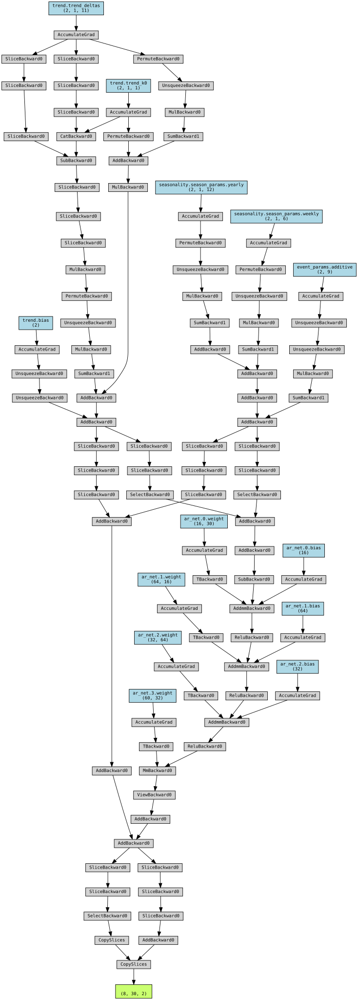

In [46]:
fig = make_dot(m.model.train_epoch_prediction, params=dict(m.model.named_parameters()))
fig.save('imagens/arquitetura_rede_neural_prophet.png')
display(fig)